Select your desired SDK mode:

1) Run in CLIENT mode 📡, connecting to a remote MOSTLY AI platform

2) Run in LOCAL mode 🏠, operating offline using your own compute

Enter your choice [1/2] (1):

Note: To skip this prompt in the future, instantiate via MostlyAI(local=True).

Alternatively set MOSTLY_LOCAL=1 as an environment variable.

Initializing Synthetic Data SDK 4.4.2 in LOCAL mode 🏠

Connected to ]8;id=864196;file:///Users/kenneth.hamilton/mostlyai\/Users/kenneth.hamilton/]8;;\]8;id=935838;file:///Users/kenneth.hamilton/mostlyai\mostlyai]8;;\ with 16 GB RAM, 10 CPUs, 0 GPUs available

Created generator 1d35cb52-87fe-4d98-a284-aa2add1965b7

Started generator training

Output()

/opt/anaconda3/envs/mostly/lib/python3.12/site-packages/mostlyai/qa/_coherence.py:95: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/opt/anaconda3/envs/mostly/lib/python3.12/site-packages/mostlyai/qa/_coherence.py:117: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/opt/anaconda3/envs/mostly/lib/python3.12/site-packages/mostlyai/qa/_coherence.py:95: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/opt/anaconda3/envs/mostly/

/opt/anaconda3/envs/mostly/lib/python3.12/site-packages/mostlyai/qa/_coherence.py:95: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/opt/anaconda3/envs/mostly/lib/python3.12/site-packages/mostlyai/qa/_coherence.py:117: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/opt/anaconda3/envs/mostly/lib/python3.12/site-packages/mostlyai/qa/_coherence.py:95: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/opt/anaconda3/envs/mostly/

🎉 Your generator is ready! Use it to create synthetic data. Publish it so others can do the same.


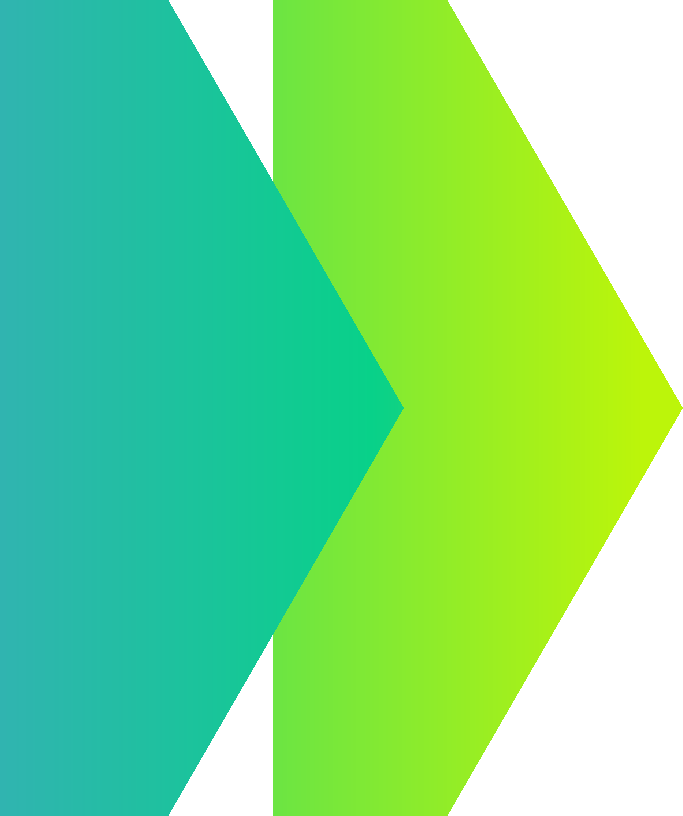
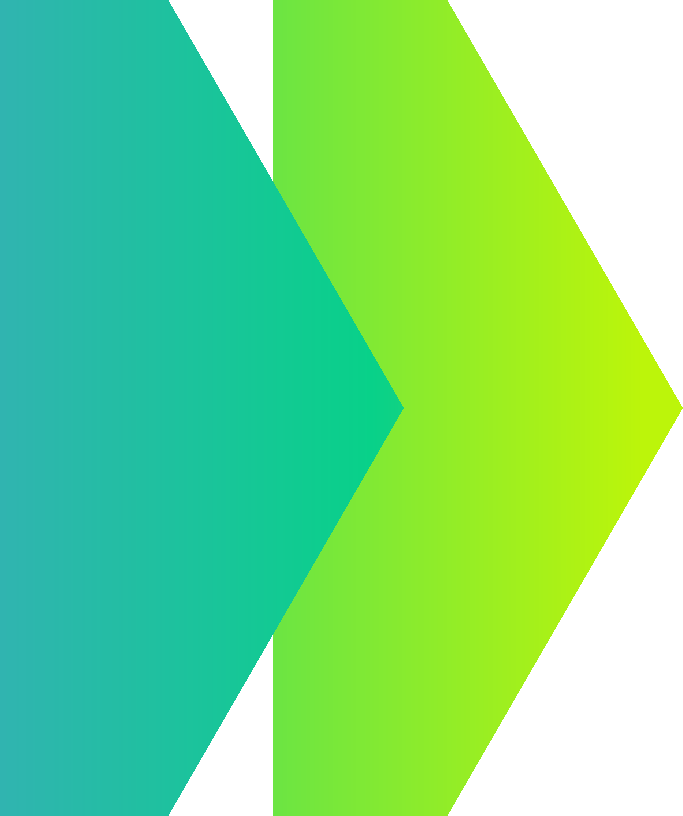
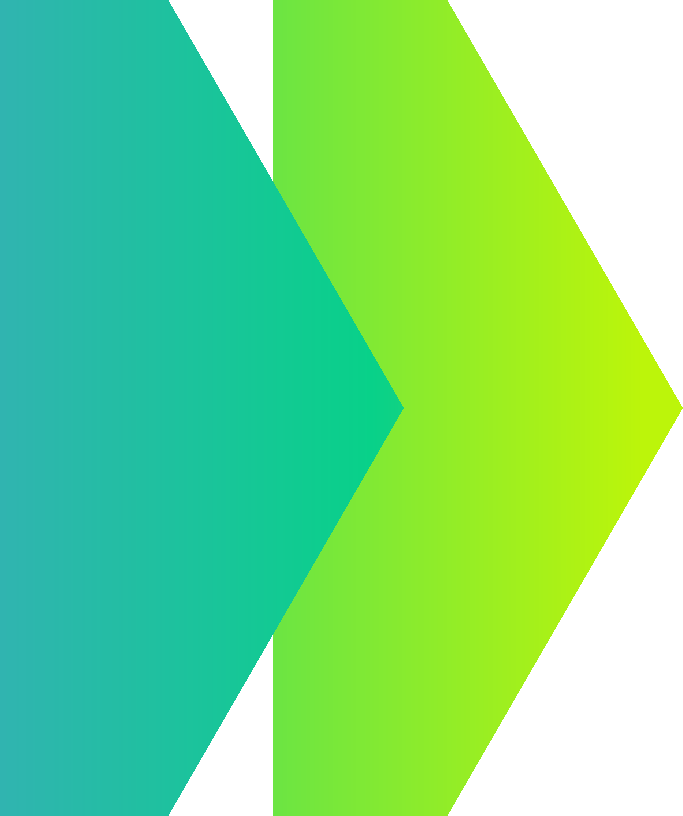
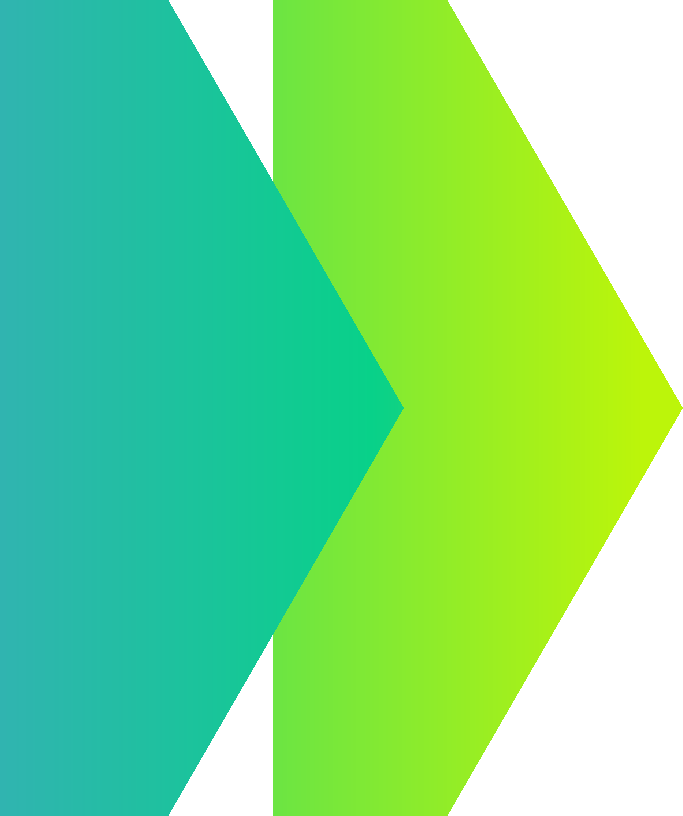
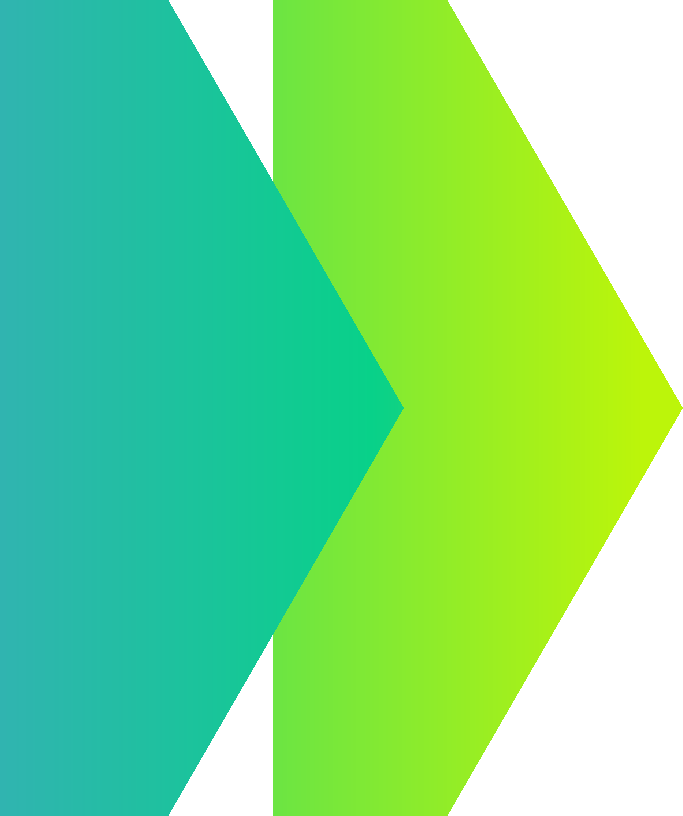
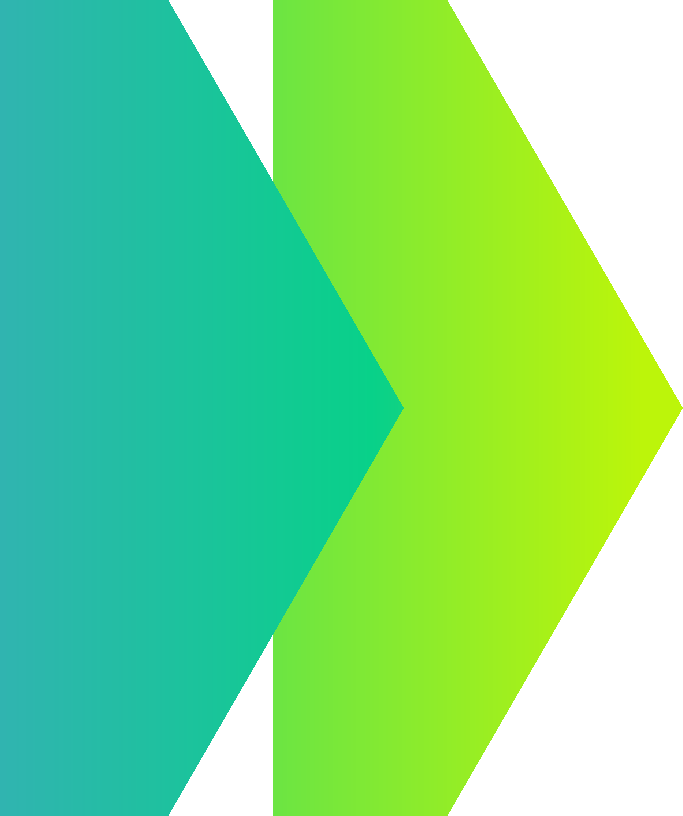
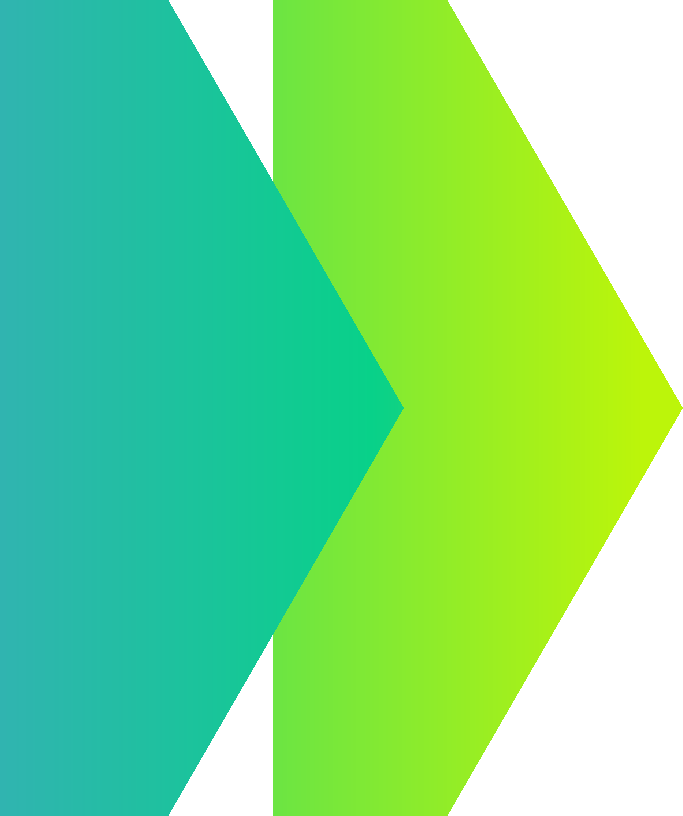
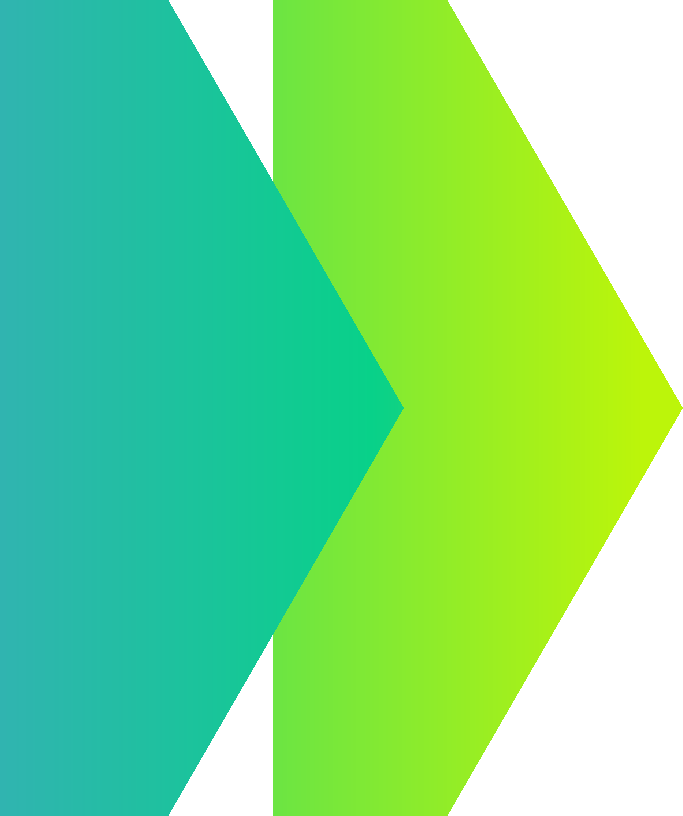
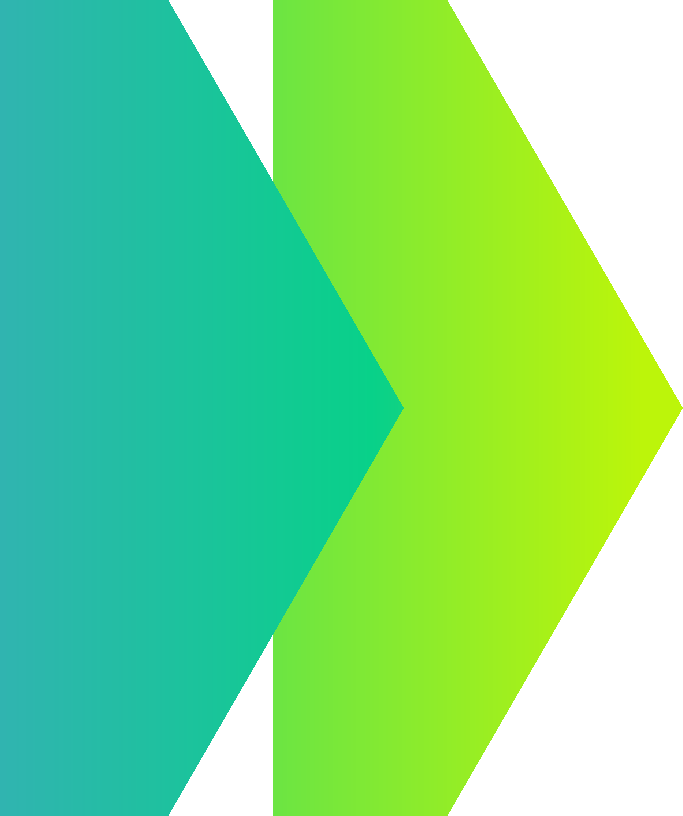

In [5]:
import pandas as pd
from mostlyai.sdk import MostlyAI

# load original data
repo_url = 'https://github.com/mostly-ai/public-demo-data/raw/dev/baseball'
df_original_players = pd.read_csv(f'{repo_url}/players.csv.gz')[['id', 'country', 'weight', 'height']]
df_original_batting = pd.read_csv(f'{repo_url}/batting.csv.gz')[['players_id', 'G', 'AB', 'R', 'H', 'HR']]
df_original_fielding = pd.read_csv(f'{repo_url}/fielding.csv.gz')[['players_id', 'POS', 'G', 'PO', 'A', 'E', 'DP']]

# instantiate SDK
mostly = MostlyAI()

# train a generator
g = mostly.train(config={
    'name': 'Baseball',                   # name of the generator
    'tables': [{                          # provide list of table(s)
        'name': 'players',                # name of the table
        'data': df_original_players,      # the original data as pd.DataFrame
        'primary_key': 'id',
        'tabular_model_configuration': {
            'max_training_time': 2,       # cap runtime for demo; set None for max accuracy
        },
    }, {
        'name': 'batting',                # name of the table
        'data': df_original_batting,      # the original data as pd.DataFrame
        'foreign_keys': [                 # foreign key configurations
            {'column': 'players_id', 'referenced_table': 'players', 'is_context': True},
        ],
        'tabular_model_configuration': {
            'max_training_time': 2,       # cap runtime for demo; set None for max accuracy
        },
    }, {
        'name': 'fielding',               # name of the table
        'data': df_original_fielding,     # the original data as pd.DataFrame
        'foreign_keys': [                 # foreign key configurations
            {'column': 'players_id', 'referenced_table': 'players', 'is_context': True},
        ],
        'tabular_model_configuration': {
            'max_training_time': 2,       # cap runtime for demo; set None for max accuracy
        },
    }],
})

# show Model QA reports
g.reports(display=True)

In [6]:
sd = mostly.generate(g, size=10_000)
syn = sd.data()
display(syn['players'].sort_values('id'))
display(syn['batting'].sort_values('players_id'))
display(syn['fielding'].sort_values('players_id'))

Created synthetic dataset e5b051f9-335a-408e-82ff-ca664415b18a with generator 1d35cb52-87fe-4d98-a284-aa2add1965b7

Started synthetic dataset generation

Output()

/opt/anaconda3/envs/mostly/lib/python3.12/site-packages/mostlyai/qa/_coherence.py:95: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/opt/anaconda3/envs/mostly/lib/python3.12/site-packages/mostlyai/qa/_coherence.py:117: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



/opt/anaconda3/envs/mostly/lib/python3.12/site-packages/mostlyai/qa/_coherence.py:95: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/opt/anaconda3/envs/mostly/lib/python3.12/site-packages/mostlyai/qa/_coherence.py:117: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



🎉 Your synthetic dataset is ready! Use it to consume the generated data. Publish it so others can do the same.

,id,country,weight,height
5805,mostly00-027d-4b0d-a87c-62e834d2b60e,USA,178,70
902,mostly00-041f-46ac-82b3-98d5bb9ac94b,USA,180,71
1564,mostly00-0551-4d4f-8bd6-476bfc5c9df8,USA,160,71
5088,mostly00-06e9-41fc-a1ca-65743ff58421,USA,220,80
8725,mostly00-085d-4bc9-ad4b-84a79f211ad9,USA,185,69
...,...,...,...,...
3138,mostlyff-e135-4349-8a72-aa49e21f9fce,USA,185,72
3211,mostlyff-f46d-4949-bc78-43e18aef7a4c,USA,160,70
836,mostlyff-fb1b-4370-9113-c142f32a36b3,USA,198,75
7035,mostlyff-fc75-425f-9c78-322d2663e291,USA,250,77


,players_id,G,AB,R,H,HR
50024,mostly00-027d-4b0d-a87c-62e834d2b60e,77,355,40,4,5
38545,mostly00-027d-4b0d-a87c-62e834d2b60e,155,587,84,188,12
45094,mostly00-027d-4b0d-a87c-62e834d2b60e,107,367,58,198,8
18453,mostly00-027d-4b0d-a87c-62e834d2b60e,50,563,18,47,5
51895,mostly00-027d-4b0d-a87c-62e834d2b60e,123,479,40,162,5
...,...,...,...,...,...,...
54453,mostlyff-fc75-425f-9c78-322d2663e291,9,2,0,0,0
7375,mostlyff-fc75-425f-9c78-322d2663e291,15,0,0,0,0
32856,mostlyff-fc75-425f-9c78-322d2663e291,58,70,2,6,0
46799,mostlyff-fc75-425f-9c78-322d2663e291,26,15,6,15,0


,players_id,POS,G,PO,A,E,DP
46280,mostly00-027d-4b0d-a87c-62e834d2b60e,2B,41,406,378,15,4
64491,mostly00-027d-4b0d-a87c-62e834d2b60e,3B,101,6,11,0,6
16824,mostly00-027d-4b0d-a87c-62e834d2b60e,1B,1,0,0,0,0
57742,mostly00-027d-4b0d-a87c-62e834d2b60e,3B,3,0,0,0,0
61647,mostly00-027d-4b0d-a87c-62e834d2b60e,OF,103,0,1,0,0
...,...,...,...,...,...,...,...
11216,mostlyff-fc75-425f-9c78-322d2663e291,C,21,68,0,0,0
18751,mostlyff-fc75-425f-9c78-322d2663e291,C,72,284,0,0,1
60399,mostlyff-fc75-425f-9c78-322d2663e291,C,20,219,1,1,0
53445,mostlyff-fc75-425f-9c78-322d2663e291,1B,7,20,4,1,0


In [12]:
print(syn)

{'players':                                         id country  weight  height
0     mostly62-d90a-456e-b32c-97b61f111e1c     USA     155      66
1     mostlyf6-bb90-40a4-9c81-43270991f579     USA     240      72
2     mostly2f-04c1-4309-8db7-7858f2ae8223     USA     185      71
3     mostly97-17fb-41b9-a577-92bbdf7a5d0a     USA     170      72
4     mostlyb2-0bec-46b5-b299-a09121a348ca     USA     180      70
...                                    ...     ...     ...     ...
9995  mostly30-01ac-4021-be96-a63ae166cc98     USA     195      74
9996  mostly24-60ce-49fc-a434-55c8b17ad394     USA     188      75
9997  mostly3a-7f63-443f-91e0-bcb18d73de09     USA     205      74
9998  mostly3d-4671-46c9-abdc-5b81399a5a9c     USA     160      67
9999  mostlyb9-65ef-47e0-982c-355f8e0f2e24     USA     180      70

[10000 rows x 4 columns], 'batting':                                  players_id    G   AB   R   H  HR
0      mostly5b-78a7-43f2-9c36-559b7d24bacf   15   38   4   8   0
1      mostly9

In [ ]:
from datasets import Dataset, DatasetDict

# Convert each DataFrame to a Hugging Face Dataset
players_dataset = Dataset.from_pandas(syn['players'])
batting_dataset = Dataset.from_pandas(syn['batting'])
fielding_dataset = Dataset.from_pandas(syn['fielding'])

# Combine them into a DatasetDict
combined_dataset = DatasetDict({
    'players': players_dataset,
    'batting': batting_dataset,
    'fielding': fielding_dataset
})